In [1]:
#importing packages

import os                                               
import pandas as pd
import numpy as np
from matplotlib import pyplot as plt 
import matplotlib.colors as mcolors


import seaborn as sns 

import random
import math
import time
import datetime
import operator 

import warnings
warnings.filterwarnings("ignore")

import plotly.offline as pyo
pyo.init_notebook_mode()
import plotly.graph_objects as go
import plotly.express as px
import plotly.io as pio
pio.templates.default = "seaborn"
from plotly.subplots import make_subplots
cnfm, dth, recd, actv = '#393e46', '#ff2e63', '#c0f762', '#fe9801' 

from IPython.core.display import HTML
from IPython.display import Image
from IPython.display import Markdown
def bold(string):
    display(Markdown(string))

In [2]:
#setting the working directory

os.chdir('E:\\Jupyter\\Datasets')   

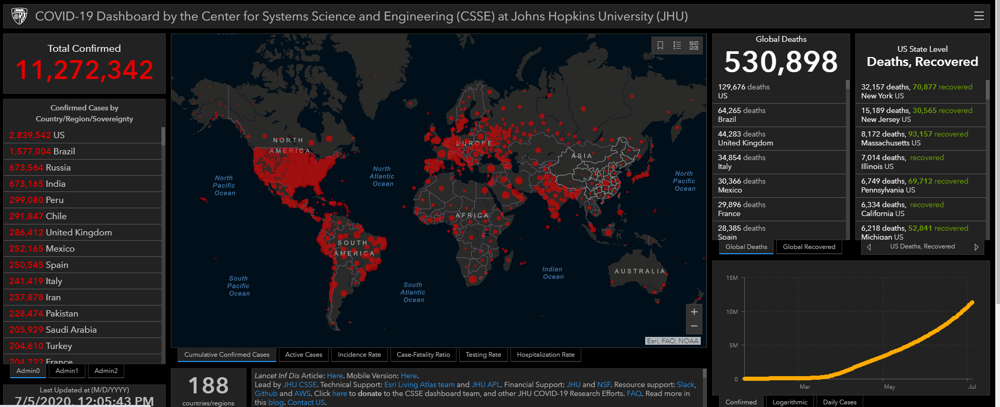

In [3]:
Image('7_7.PNG')

In [4]:
pd.set_option("display.max_columns",None) 
pd.set_option("display.max_rows",None) 

In [5]:
sns.set(style="darkgrid", palette="pastel", color_codes=True)
sns.set_context("paper")

In [6]:
#importing the file as a dataframe

coronavirus = pd.read_csv('covid_19_clean_complete2.csv')

#prints summary information about the file 
coronavirus.info()


<class 'pandas.core.frame.DataFrame'>
RangeIndex: 42543 entries, 0 to 42542
Data columns (total 10 columns):
 #   Column          Non-Null Count  Dtype  
---  ------          --------------  -----  
 0   Province/State  12714 non-null  object 
 1   Country/Region  42543 non-null  object 
 2   Lat             42543 non-null  float64
 3   Long            42543 non-null  float64
 4   Date            42543 non-null  object 
 5   Confirmed       42543 non-null  int64  
 6   Deaths          42543 non-null  int64  
 7   Recovered       42543 non-null  int64  
 8   Active          42543 non-null  int64  
 9   WHO Region      42543 non-null  object 
dtypes: float64(2), int64(4), object(4)
memory usage: 3.2+ MB


In [7]:
#Some characteristics of the dataset

In [8]:
coronavirus.info

<bound method DataFrame.info of                      Province/State                    Country/Region  \
0                               NaN                       Afghanistan   
1                               NaN                           Albania   
2                               NaN                           Algeria   
3                               NaN                           Andorra   
4                               NaN                            Angola   
5                               NaN               Antigua and Barbuda   
6                               NaN                         Argentina   
7                               NaN                           Armenia   
8      Australian Capital Territory                         Australia   
9                   New South Wales                         Australia   
10               Northern Territory                         Australia   
11                       Queensland                         Australia   
12                 

In [9]:
coronavirus.head()

,Province/State,Country/Region,Lat,Long,Date,Confirmed,Deaths,Recovered,Active,WHO Region
0,NaN,Afghanistan,33.0000,65.0000,2020-01-22,0,0,0,0,Eastern Mediterranean
1,NaN,Albania,41.1533,20.1683,2020-01-22,0,0,0,0,Europe
2,NaN,Algeria,28.0339,1.6596,2020-01-22,0,0,0,0,Africa
3,NaN,Andorra,42.5063,1.5218,2020-01-22,0,0,0,0,Europe
4,NaN,Angola,-11.2027,17.8739,2020-01-22,0,0,0,0,Africa


In [10]:
coronavirus.tail()


,Province/State,Country/Region,Lat,Long,Date,Confirmed,Deaths,Recovered,Active,WHO Region
42538,NaN,Sao Tome and Principe,0.186360,6.613081,2020-07-02,717,13,260,444,Africa
42539,NaN,Yemen,15.552727,48.516388,2020-07-02,1221,325,513,383,Eastern Mediterranean
42540,NaN,Comoros,-11.645500,43.333300,2020-07-02,303,7,200,96,Africa
42541,NaN,Tajikistan,38.861034,71.276093,2020-07-02,6058,52,4690,1316,Europe
42542,NaN,Lesotho,-29.609988,28.233608,2020-07-02,35,0,11,24,Africa


In [11]:
coronavirus.columns


Index(['Province/State', 'Country/Region', 'Lat', 'Long', 'Date', 'Confirmed',
       'Deaths', 'Recovered', 'Active', 'WHO Region'],
      dtype='object')

In [12]:
coronavirus.isnull().sum()

Province/State    29829
Country/Region        0
Lat                   0
Long                  0
Date                  0
Confirmed             0
Deaths                0
Recovered             0
Active                0
WHO Region            0
dtype: int64

In [13]:
#Renaming the coulmns for ease of usage
coronavirus.rename(columns={ 
                     'Province/State':'state',
                     'Country/Region':'country',
                    }, inplace=True)

# Active Case = confirmed - deaths - recovered
coronavirus['Active'] = coronavirus['Confirmed'] - coronavirus['Deaths'] - coronavirus['Recovered']

In [14]:
#Visualizing for World Wide Spread Of the Pandemic

In [15]:
cv1 = coronavirus
cv1['Date'] = pd.to_datetime(cv1['Date'])
cv1['Date'] = cv1['Date'].dt.strftime('%m/%d/%Y')
cv1 = cv1.fillna(' -')
fig = px.density_mapbox(cv1, lat='Lat', lon='Long', z='Confirmed', radius=20, zoom=1, hover_data=["country",'state',"Confirmed"],
                        mapbox_style="carto-positron", animation_frame = 'Date', range_color= [0, 3000],title='The World Wide Spread of the Pandemic')
fig.update_layout(margin={"r":0,"t":30,"l":0,"b":0})
fig.show()


In [16]:
#Active cases around the world

In [17]:
AC = coronavirus[coronavirus['Date'] == coronavirus['Date'].max()]
world = AC.groupby('country')['Confirmed','Active','Deaths'].sum().reset_index()
world.head(n=10)

,country,Confirmed,Active,Deaths
0,Afghanistan,32022,15174,807
1,Albania,2662,1034,69
2,Algeria,14657,3387,928
3,Andorra,855,3,52
4,Angola,315,201,17
5,Antigua and Barbuda,69,43,3
6,Argentina,69941,44370,1385
7,Armenia,26658,11163,459
8,Australia,8066,832,104
9,Austria,17941,722,705


In [18]:
figure = px.choropleth(world, locations="country", 
                    locationmode='country names', color="Active", 
                    hover_name="country", range_color=[1,100000], 
                    color_continuous_scale="Sunsetdark", 
                    title='Countries with Active Cases')
figure.show()

In [19]:
#Top 20 countries having the most comfirmed cases 

In [20]:
top_20 = coronavirus[coronavirus['Date'] == coronavirus['Date'].max()]
top_casualities = top_20.groupby(by = 'country')['Confirmed'].sum().sort_values(ascending = False).head(20).reset_index()
top_casualities

,country,Confirmed
0,US,2739879
1,Brazil,1496858
2,Russia,660231
3,India,625544
4,Peru,292004
5,United Kingdom,285268
6,Chile,284541
7,Spain,250103
8,Italy,240961
9,Mexico,238511


In [21]:
#plotting top_20 countries having the most confirmed cases 

[Text(0, 0.5, 'Country'), Text(0.5, 0, 'Total cases')]

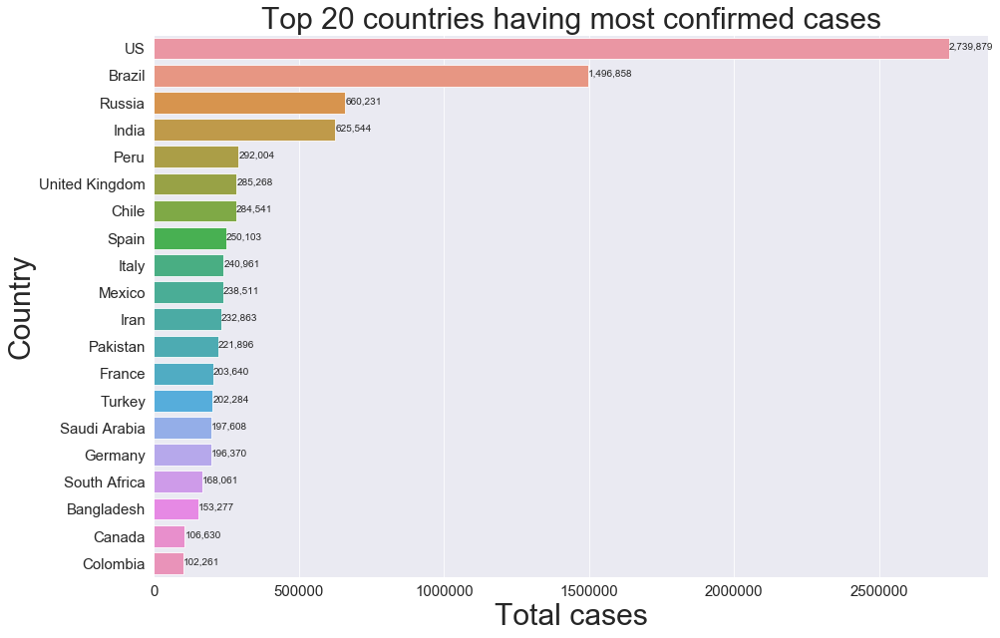

In [22]:
plt.figure(figsize= (15,10))
plt.xticks(fontsize = 15)
plt.yticks(fontsize = 15)
plt.xlabel("Total cases",fontsize = 30)
plt.ylabel('Country',fontsize = 30)
plt.title("Top 20 countries having most confirmed cases" , fontsize = 30)
ax = sns.barplot(x = top_casualities.Confirmed, y = top_casualities.country)
for i, (value, name) in enumerate(zip(top_casualities.Confirmed,top_casualities.country)):
    ax.text(value, i-.05, f'{value:,.0f}',  size=10, ha='left',  va='center')
ax.set(xlabel='Total cases', ylabel='Country')

In [23]:
#Top 20 countries having the most active cases

In [24]:
top_actives = top_20.groupby(by = 'country')['Active'].sum().sort_values(ascending = False).head(20).reset_index()
top_actives

,country,Active
0,US,1829169
1,Brazil,477282
2,United Kingdom,239815
3,India,227439
4,Russia,222287
5,Pakistan,103722
6,Peru,99862
7,Canada,97931
8,France,96835
9,Bangladesh,84909


In [25]:
#Plotting the top 20 countries with the most active cases 

[Text(0, 0.5, 'Country'), Text(0.5, 0, 'Total cases')]

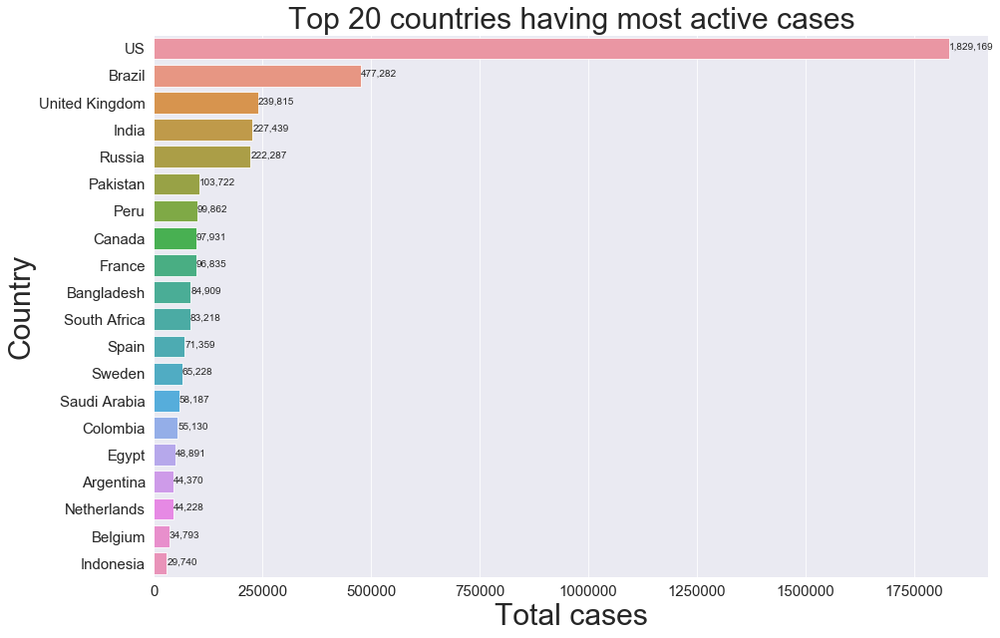

In [26]:
plt.figure(figsize= (15,10))
plt.xticks(fontsize = 15)
plt.yticks(fontsize = 15)
plt.xlabel("Total cases",fontsize = 30)
plt.ylabel('Country',fontsize = 30)
plt.title("Top 20 countries having most active cases" , fontsize = 30)
ax = sns.barplot(x = top_actives.Active, y = top_actives.country)
for i, (value, name) in enumerate(zip(top_actives.Active, top_actives.country)):
    ax.text(value, i-.05, f'{value:,.0f}',  size=10, ha='left',  va='center')
ax.set(xlabel='Total cases', ylabel='Country')

In [27]:
coronavirus.sample(6)

,state,country,Lat,Long,Date,Confirmed,Deaths,Recovered,Active,WHO Region
5385,Curacao,Netherlands,12.1696,-68.9900,02/11/2020,0,0,0,0,Europe
15118,Northwest Territories,Canada,64.8255,-124.8457,03/19/2020,0,0,0,0,Americas
17877,NaN,India,21.0000,78.0000,03/30/2020,1251,32,102,1117,South-East Asia
1879,Gansu,China,37.8099,101.0583,01/29/2020,24,0,0,24,Western Pacific
7014,NaN,Zimbabwe,-20.0000,30.0000,02/17/2020,0,0,0,0,Africa
22453,NaN,Armenia,40.0691,45.0382,04/17/2020,1201,19,402,780,Europe


In [28]:
Cases_over_time = coronavirus.groupby('Date')['Recovered', 'Deaths', 'Active'].sum().reset_index()
Cases_over_time = Cases_over_time.melt(id_vars="Date", value_vars=['Recovered', 'Deaths', 'Active'],
                 var_name='Case', value_name='Count')
Cases_over_time.head()

fig = px.area(Cases_over_time, x="Date", y="Count", color='Case', height=600,
             title='Cases over time', color_discrete_sequence = [recd, dth, actv])
fig.update_layout(xaxis_rangeslider_visible=True)
fig.show()

In [29]:
covid_IN = pd.read_csv('covid_19_india.csv')

In [30]:
covid_IN.head()

,Sno,Date,Time,State/UnionTerritory,ConfirmedIndianNational,ConfirmedForeignNational,Cured,Deaths,Confirmed
0,1,30/01/20,6:00 PM,Kerala,1,0,0,0,1
1,2,31/01/20,6:00 PM,Kerala,1,0,0,0,1
2,3,01/02/20,6:00 PM,Kerala,2,0,0,0,2
3,4,02/02/20,6:00 PM,Kerala,3,0,0,0,3
4,5,03/02/20,6:00 PM,Kerala,3,0,0,0,3


In [31]:
covid_IN.tail()

,Sno,Date,Time,State/UnionTerritory,ConfirmedIndianNational,ConfirmedForeignNational,Cured,Deaths,Confirmed
3706,3707,03/07/20,8:00 AM,Tripura,-,-,1146,1,1435
3707,3708,03/07/20,8:00 AM,Uttarakhand,-,-,2405,42,2984
3708,3709,03/07/20,8:00 AM,Uttar Pradesh,-,-,17221,735,24825
3709,3710,03/07/20,8:00 AM,West Bengal,-,-,13037,699,19819
3710,3711,03/07/20,8:00 AM,Cases being reassigned to states,-,-,0,0,6031


In [32]:
# Data cleaning
data = covid_IN.copy()
data['Date'] = data['Date'].apply(pd.to_datetime)
data.drop(['Sno', 'Time'],axis=1,inplace=True)

# collect present data
from datetime import date
data_apr = data[data['Date'] > pd.Timestamp(date(2020,1,29))]

# prepaing data state wise
state_cases = data_apr.groupby('State/UnionTerritory')['Confirmed','Deaths','Cured'].max().reset_index()
state_cases['Active'] = state_cases['Confirmed'] - (state_cases['Deaths']- state_cases['Cured'])
state_cases["Death Rate (per 100)"] = np.round(100*state_cases["Deaths"]/state_cases["Confirmed"],2)

In [33]:
bold("** Condition in India As Of 5/7/20 : Confirmed cases, Deaths, Recovered of 2019-nCoV**")
print('Total Confirmed Cases: ',state_cases['Confirmed'].sum())
print('Total Deaths: ',state_cases['Deaths'].sum())
print('Total Cured Cases: ',state_cases['Cured'].sum())
print('Death Rate (per 100): ',np.round(100*state_cases['Deaths'].sum()/state_cases['Confirmed'].sum(),2))

** Condition in India As Of 5/7/20 : Confirmed cases, Deaths, Recovered of 2019-nCoV**

Total Confirmed Cases:  632994
Total Deaths:  18369
Total Cured Cases:  381711
Death Rate (per 100):  2.9


In [34]:
bold("** STATE WISE CONFIRMED, DEATH AND CURED CASES **")
state_cases.sort_values('Confirmed', ascending= False).style.background_gradient(cmap='YlOrBr',subset=["Confirmed"])\
                        .background_gradient(cmap='Reds',subset=["Deaths"])\
                        .background_gradient(cmap='Greens',subset=["Cured"])\
                        .background_gradient(cmap='Blues',subset=["Active"])\
                        .background_gradient(cmap='Purples',subset=["Death Rate (per 100)"])

** STATE WISE CONFIRMED, DEATH AND CURED CASES **

,State/UnionTerritory,Confirmed,Deaths,Cured,Active,Death Rate (per 100)
22,Maharashtra,186626,8178,101172,279620,4.380000
32,Tamil Nadu,98392,1321,56021,153092,1.340000
11,Delhi,92175,2864,63007,152318,3.110000
13,Gujarat,33913,1886,24593,56620,5.560000
37,Uttar Pradesh,24825,735,17221,41311,2.960000
39,West Bengal,19819,699,13037,32157,3.530000
30,Rajasthan,18662,430,14948,33180,2.300000
33,Telangana,18570,275,9069,27364,1.480000
18,Karnataka,18016,272,8334,26078,1.510000
1,Andhra Pradesh,16097,198,7313,23212,1.230000


In [35]:
bold('** Confirmed Cases In India - A Projection **')

** Confirmed Cases In India - A Projection **

In [36]:
HTML('''<div class="flourish-embed flourish-map" data-src="visualisation/2135067" data-url="https://flo.uri.sh/visualisation/2135067/embed"><script src="https://public.flourish.studio/resources/embed.js"></script></div> ''')

In [37]:
hotspot = pd.read_csv('IndividualDetails.csv', usecols = ['detected_city', 'notes'])
detected_city = hotspot['detected_city'].value_counts().reset_index()
detected_city.rename(columns={"index":"Cities",
                            "detected_city": "Counts"}, inplace=True)
plt = px.bar(detected_city.sort_values('Counts', ascending=True).sort_values('Counts', ascending=False).head(15), 
             y="Counts", x="Cities", color= "Cities",
             title='Hotspots as of 5/7/20 ', 
             orientation='v',
             color_discrete_sequence = px.colors.cyclical.IceFire,
             width=700, height=600)
plt.update_traces(opacity=0.8)

plt.update_layout(template = 'plotly_white')
plt.show()

In [38]:
hotspot.head()

,detected_city,notes
0,Thrissur,Travelled from Wuhan
1,Alappuzha,Travelled from Wuhan
2,Kasaragod,Travelled from Wuhan
3,East Delhi (Mayur Vihar),"Travelled from Austria, Italy"
4,Hyderabad,"Travelled from Dubai to Bangalore on 20th Feb,..."


In [39]:
age_wise = pd.read_csv('AgeGroupDetails.csv')
fig = make_subplots(rows=1, cols=2)
colors = ['lightcyan', 'orange', 'aqua','gold', 'palegreen', 'grey',  'limegreen','navy','crimson','purple']
trace1 = go.Pie(
                labels=age_wise.AgeGroup,
                values=age_wise.TotalCases,
                hoverinfo='label+percent', 
                textfont_size=12,
                marker=dict(colors=colors, 
                            line=dict(color='#000000', width=2)))
layout = go.Layout(width=700, height=500,title_text = '<b> # People Affected By Covid-19 in India <br> Pie Distribution By Age Group</b>',
                  font=dict(family="Arial, Balto, Courier New, Droid Sans",color='black'))
fig = go.Figure(data = [trace1], layout = layout)
fig.show()

colors = ['lightslategray']*10 
colors[2] = 'crimson'
trace2 = go.Bar(
            x=age_wise.AgeGroup, 
            y=age_wise.TotalCases,
            text=age_wise.TotalCases,
            textposition='auto',
            marker_color=colors)
layout = go.Layout(template="ggplot2",width=700, height=500, )

fig = go.Figure(data = [trace2], layout = layout)
fig.show()

In [40]:
import requests
IN_test = pd.io.json.json_normalize(requests.get('https://api.rootnet.in/covid19-in/stats/testing/history').json()['data'])
IN_test.drop(['totalIndividualsTested','source'], axis=1, inplace=True)
IN_test['day'] = IN_test['day'].apply(pd.to_datetime)

IN_test["totalSamplesTested_diff"] = IN_test["totalSamplesTested"].diff()
IN_test["totalPositiveCases_diff"] = IN_test["totalPositiveCases"].diff()
IN_test["p2t_ratio"]= np.round(100*IN_test["totalPositiveCases_diff"]/IN_test["totalSamplesTested_diff"],2)

In [41]:
pop = pd.read_csv('population_india_census2011.csv')
pop.rename(columns={'State / Union Territory': 'State/UnionTerritory'}, inplace=True)

pop_case = state_cases.merge(pop[['State/UnionTerritory', 'Population']], on='State/UnionTerritory')

In [42]:
bold("** Sample Tested for COVID-19 in India**")
print('Total Sample Tested: ',IN_test['totalSamplesTested'].max())
print('Total Positive to Test Ratio:',np.round(100*IN_test["totalPositiveCases"].max()/IN_test["totalSamplesTested"].max(),2))
print('Tests Per Million Peoples:', np.round(100000*IN_test["totalSamplesTested"].max()/pop_case["Population"].sum(),2))

** Sample Tested for COVID-19 in India**

Total Sample Tested:  22788393.0
Total Positive to Test Ratio: 0.1
Tests Per Million Peoples: 1882.55


In [43]:

fig1 = go.Figure(data=[go.Bar(
            x=IN_test.day, 
            y=IN_test.totalSamplesTested_diff,
            name='Test (Negative Case )',
            marker_color='#111212'),
            
            go.Bar(
            x=IN_test.day, 
            y=IN_test.totalPositiveCases_diff,
            name='Test (Positve Case)',
            marker_color='#877cf2')])

# Change the bar mode
fig1.update_layout(barmode='stack', template="ggplot2",width=700, height=500, title_text = '<b>Sample Tested for COVID-19 in India (Day Wise)</b>',
                  font=dict(family="Arial, Balto, Courier New, Droid Sans",color='black'))
fig1.show()

In [44]:
testing = pd.read_csv("testing_details_by_country_updated.csv")

In [45]:
testing['Date'] = testing['Date'].apply(pd.to_datetime)
testing.set_index(["Entity"], inplace = True)
testing = testing.loc[['Italy', 'Japan','India', 'South Korea', 'United States']]
testing.reset_index(inplace = True)
testing.sort_values('Date', ascending= True,inplace=True)

# plot
plt = px.scatter(testing, 
                 x='Date', 
                 y='Total tests', 
                 color='Entity')
plt.update_traces(marker=dict(size=3.5),
                  mode='lines+markers')

plt.add_annotation(text="South Korea's Rapid Testing ", x='2020-03-01', y=100000, arrowhead=1, 
                   showarrow=True)

plt.add_annotation(text="Testing started very late in US", x='2020-03-17', y=100000, arrowhead=4, ax=0,
            ay=-60,showarrow=True)

plt.add_annotation(text="India Going Slow", x='2020-04-18', y=370000, arrowhead=1, ax=0,
            ay=-60,showarrow=True)


plt.update_layout(template = 'plotly_white',width=700, height=500, title_text = '<b>Total Tests for COVID-19</b>',
                  font=dict(family="Arial, Balto, Courier New, Droid Sans",color='black'))
plt.show()

In [46]:
bold(" Medical Facilities In India ")

 Medical Facilities In India 

In [47]:
hsp_beds = pd.read_csv('HospitalBedsIndia.csv')
hsp_beds.head()

,Sno,State/UT,NumPrimaryHealthCenters_HMIS,NumCommunityHealthCenters_HMIS,NumSubDistrictHospitals_HMIS,NumDistrictHospitals_HMIS,TotalPublicHealthFacilities_HMIS,NumPublicBeds_HMIS,NumRuralHospitals_NHP18,NumRuralBeds_NHP18,NumUrbanHospitals_NHP18,NumUrbanBeds_NHP18
0,1,Andaman & Nicobar Islands,27,4,NaN,3,34,1246,27,575,3,500
1,2,Andhra Pradesh,1417,198,31.0,20,1666,60799,193,6480,65,16658
2,3,Arunachal Pradesh,122,62,NaN,15,199,2320,208,2136,10,268
3,4,Assam,1007,166,14.0,33,1220,19115,1176,10944,50,6198
4,5,Bihar,2007,63,33.0,43,2146,17796,930,6083,103,5936


In [48]:
hsp_beds.drop([36], inplace=True)
hsp_beds.fillna('0', inplace=True)
hsp_beds['NumPrimaryHealthCenters_HMIS'] = hsp_beds['NumPrimaryHealthCenters_HMIS'].str.replace(',', '').astype(int)
hsp_beds['NumCommunityHealthCenters_HMIS'] = hsp_beds['NumCommunityHealthCenters_HMIS'].replace(',', '').astype(int)
hsp_beds['NumSubDistrictHospitals_HMIS'] = hsp_beds['NumSubDistrictHospitals_HMIS'].replace(',', '').astype(int)
hsp_beds['NumDistrictHospitals_HMIS'] = hsp_beds['NumDistrictHospitals_HMIS'].replace(',', '').astype(int)
hsp_beds['TotalPublicHealthFacilities_HMIS'] = hsp_beds['TotalPublicHealthFacilities_HMIS'].replace(',', '').astype(int)
hsp_beds['NumPublicBeds_HMIS'] = hsp_beds['NumPublicBeds_HMIS'].replace(',', '').astype(int)
hsp_beds['TotalBeds'] = hsp_beds[['NumPublicBeds_HMIS', 'NumRuralBeds_NHP18', 'NumUrbanBeds_NHP18']].sum(axis=1)

hsp_beds.rename(columns={'State/UT': 'State/UnionTerritory'}, inplace=True)
hsp_beds_pop = hsp_beds.merge(pop[['State/UnionTerritory', 'Population']], on='State/UnionTerritory')

hsp_beds_pop['Num Beds Per 1000 person'] = np.round(1000*hsp_beds_pop["TotalBeds"]/hsp_beds_pop["Population"],2)

In [49]:
plt = go.Figure(data=[go.Bar(
            x=hsp_beds_pop['State/UnionTerritory'], 
            y=hsp_beds_pop.NumPrimaryHealthCenters_HMIS,
            name='Primary Health Centers',
            marker_color='#323036'),
            
            go.Bar(
            x=hsp_beds_pop['State/UnionTerritory'], 
            y=hsp_beds_pop.NumCommunityHealthCenters_HMIS,
            name='Community Health Centers',
            marker_color='#f516e2'),
            
            go.Bar(
            x=hsp_beds_pop['State/UnionTerritory'], 
            y=hsp_beds_pop.NumDistrictHospitals_HMIS,
            name='District Hospitals',
            marker_color='#73f5ab'),

            go.Bar(
            x=hsp_beds_pop['State/UnionTerritory'], 
            y=hsp_beds_pop.NumSubDistrictHospitals_HMIS,
            name='Sub-District Hospitals',
            marker_color='#FFD700')])


# Stacked Bar Chart
plt.update_layout(barmode='stack', template="ggplot2",width=700, height=700, title_text = '<b> Health Facilities</b>',
                  font=dict(family="Arial, Balto, Courier New, Droid Sans",color='black'))
plt.show()

In [50]:
plt = px.bar(hsp_beds_pop, 
             x='State/UnionTerritory', y="TotalBeds",  
             text='TotalBeds', 
             orientation='v')
plt.update_traces(marker_color='#14e4f7', opacity=0.8, textposition='inside')

plt.update_layout(template="ggplot2",width=700, height=700, title_text = '<b>Total Hospital Beds</b>',
                  font=dict(family="Arial, Balto, Courier New, Droid Sans",color='black'))
plt.show()

plt1 = px.scatter(hsp_beds_pop, 
             x='State/UnionTerritory', y="Num Beds Per 1000 person")
plt1.update_traces(marker=dict(size=12,
                              line=dict(width=2,
                                        color='DarkSlateGrey')),
                  marker_color='#8eb9fa',
                  mode='lines+markers')

plt1.update_layout(template="plotly_white",width=700, height=700, title_text = '<b>Number of Hospital Beds Available Per 1000 Individuals</b>',
                  font=dict(family="Arial, Balto, Courier New, Droid Sans",color='black'))
plt1.show()

In [51]:
#What Should to be done 

In [52]:
HTML(''' <iframe src="https://giphy.com/embed/WOkuHrhNv4LQVeSoik" width="480" height="337" frameBorder="0" class="giphy-embed" allowFullScreen></iframe><p><a href="https://giphy.com/gifs/originals-covid-psa-19-WOkuHrhNv4LQVeSoik">via GIPHY</a></p>''')

In [53]:
HTML(''' <iframe src="https://giphy.com/embed/Qu1fT51CG14ksIkASL" width="480" height="480" frameBorder="0" class="giphy-embed" allowFullScreen></iframe><p><a href="https://giphy.com/gifs/IntoAction-chart-stay-home-stayhome-Qu1fT51CG14ksIkASL">via GIPHY</a></p>''')

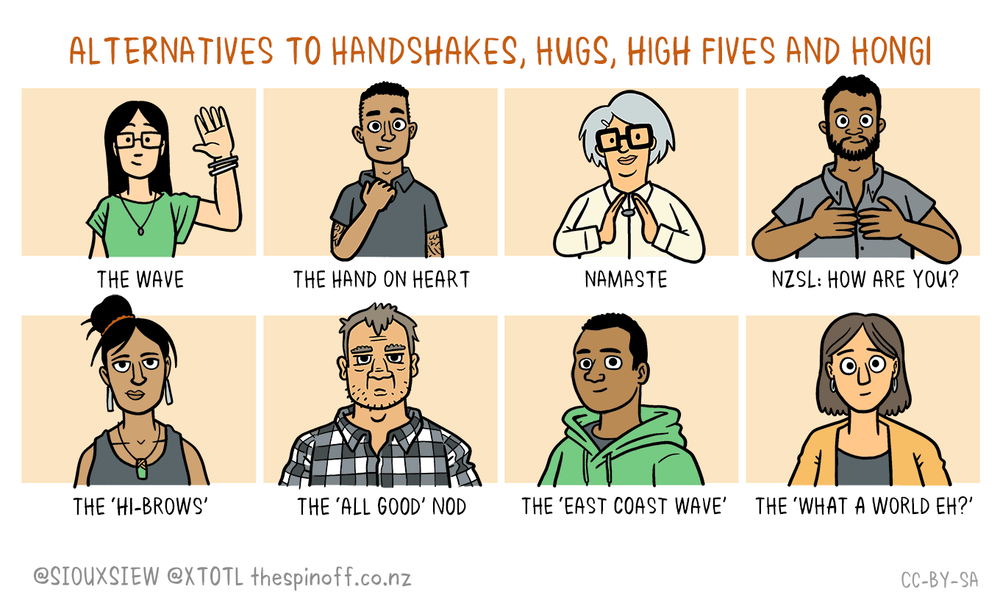

In [54]:
Image('Covid-19-Handshake-Alternatives-v3.gif')